In [1]:
import ast
import json
import re
import itertools
import pandas as pd
import numpy as np
from pathlib import Path

# 1.数据探索分析与预处理

## 1.1 导入数据并查看

In [2]:
# ───────────────────────── 1. 读取费城数据 ───────────────────────── #
import pandas as pd

DATA_PATH = "./yelp_business.csv"
df = pd.read_csv(DATA_PATH)

# 筛选出费城（Philadelphia）数据
df = df[df["city"].str.lower() == "philadelphia"]

# 从中随机采样最多 20000 条（如果不足就取全部）
df = df.sample(n=min(20000, len(df)), random_state=42)

print(df.shape)
df


(14576, 14)


,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
129812,QVu5RffO04nc7JWT8pqlQw,Nan Yang Asian Cuisine,932 Race St,Philadelphia,PA,19107,39.955170,-75.155510,3.5,15,0,"{'GoodForKids': 'True', 'RestaurantsTakeOut': ...","Thai, Restaurants, Singaporean, Malaysian, Asi...","{'Monday': '11:0-2:0', 'Wednesday': '11:0-2:0'..."
99663,m_5jK3w7t4CS2ReIZI_grQ,Fat Tuesday,431 S St,Philadelphia,PA,19147,39.941876,-75.150251,2.5,196,1,"{'Alcohol': ""u'full_bar'"", 'HasTV': 'True', 'R...","Ice Cream & Frozen Yogurt, Restaurants, Americ...","{'Monday': '12:0-2:0', 'Tuesday': '12:0-2:0', ..."
33945,e3Y3hDpwHc9RmQlJtIgHuw,Lacroix Restaurant at The Rittenhouse,210 W Rittenhouse Sq,Philadelphia,PA,19103,39.949913,-75.173645,4.5,434,1,"{'RestaurantsPriceRange2': '4', 'WiFi': ""u'fre...","Restaurants, Breakfast & Brunch, Brazilian, Am...","{'Monday': '17:30-22:30', 'Tuesday': '17:30-21..."
70513,r1g9VYLve8rfL3NUqA4uWw,Recess Lounge,125 S 2nd St,Philadelphia,PA,19106,39.947602,-75.144463,2.0,42,1,"{'BusinessAcceptsCreditCards': 'True', 'Alcoho...","Lounges, Nightlife, Bars","{'Thursday': '22:0-3:0', 'Friday': '22:0-3:0',..."
122480,htkrEPPQg6iH2QoBDjrEJw,Fresh Donuts,3914 Lancaster Ave,Philadelphia,PA,19104,39.962212,-75.201024,5.0,22,1,"{'RestaurantsPriceRange2': '1', 'BikeParking':...","Donuts, Breakfast & Brunch, Restaurants, Coffe...","{'Monday': '6:0-17:0', 'Tuesday': '6:0-17:0', ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53580,IRsSA1CAr-GFRr_80h0hBQ,Rittenhouse Hill Apartments,633 W Rittenhouse St,Philadelphia,PA,19144,40.030840,-75.185545,3.5,105,1,"{'BusinessAcceptsCreditCards': 'True', 'ByAppo...","Home Services, Apartments, Real Estate","{'Monday': '10:0-19:0', 'Tuesday': '10:0-19:0'..."
138523,vP0Un0I4ttXgjEnYbmwUIw,Rita's Italian Ice,1511 Spruce St,Philadelphia,PA,19102,39.947359,-75.166932,4.0,83,1,"{'RestaurantsPriceRange2': '1', 'BusinessParki...","Ice Cream & Frozen Yogurt, Desserts, Food, Sha...","{'Monday': '13:0-20:0', 'Tuesday': '13:0-20:0'..."
55466,gr5EVvwHgss4__ZDoixUqQ,Bala Apartments,4920 City Ave,Philadelphia,PA,19131,40.000290,-75.227743,1.0,7,1,NaN,"Home Services, Apartments, Real Estate","{'Monday': '10:0-18:0', 'Tuesday': '10:0-18:0'..."
8817,c6DUOuLuX8pKVNgKUlZf9A,Brindle Cafe,221 E Girard Ave,Philadelphia,PA,19125,39.969448,-75.133196,3.0,9,0,"{'NoiseLevel': ""u'quiet'"", 'RestaurantsGoodFor...","Sandwiches, Restaurants, American (New)","{'Tuesday': '11:0-21:0', 'Wednesday': '11:0-21..."


## 1.2检查数据质量

In [3]:
# 查看数据集缺失情况
missing_values_count = df.isnull().sum()
print(missing_values_count)

business_id        0
name               0
address          526
city               0
state              0
postal_code        8
latitude           0
longitude          0
stars              0
review_count       0
is_open            0
attributes      1170
categories         9
hours           2784
dtype: int64


发现：缺失值较少 将字段存在缺失值的行删去  
并且我们是新门店预测,"is_open" "review_count"等信息可以删去

In [4]:
df = df.dropna(subset = ['categories','attributes','hours'])
missing_values_count = df.isnull().sum()
print(missing_values_count)
df = df.reset_index(drop=True)
cols_to_drop = ["is_open", "review_count", "postal_code", "address"]
df = df.drop(columns=cols_to_drop, errors="ignore")   # errors="ignore" 可防止列已不存在时报错
df

business_id       0
name              0
address         376
city              0
state             0
postal_code       4
latitude          0
longitude         0
stars             0
review_count      0
is_open           0
attributes        0
categories        0
hours             0
dtype: int64


,business_id,name,city,state,latitude,longitude,stars,attributes,categories,hours
0,QVu5RffO04nc7JWT8pqlQw,Nan Yang Asian Cuisine,Philadelphia,PA,39.955170,-75.155510,3.5,"{'GoodForKids': 'True', 'RestaurantsTakeOut': ...","Thai, Restaurants, Singaporean, Malaysian, Asi...","{'Monday': '11:0-2:0', 'Wednesday': '11:0-2:0'..."
1,m_5jK3w7t4CS2ReIZI_grQ,Fat Tuesday,Philadelphia,PA,39.941876,-75.150251,2.5,"{'Alcohol': ""u'full_bar'"", 'HasTV': 'True', 'R...","Ice Cream & Frozen Yogurt, Restaurants, Americ...","{'Monday': '12:0-2:0', 'Tuesday': '12:0-2:0', ..."
2,e3Y3hDpwHc9RmQlJtIgHuw,Lacroix Restaurant at The Rittenhouse,Philadelphia,PA,39.949913,-75.173645,4.5,"{'RestaurantsPriceRange2': '4', 'WiFi': ""u'fre...","Restaurants, Breakfast & Brunch, Brazilian, Am...","{'Monday': '17:30-22:30', 'Tuesday': '17:30-21..."
3,r1g9VYLve8rfL3NUqA4uWw,Recess Lounge,Philadelphia,PA,39.947602,-75.144463,2.0,"{'BusinessAcceptsCreditCards': 'True', 'Alcoho...","Lounges, Nightlife, Bars","{'Thursday': '22:0-3:0', 'Friday': '22:0-3:0',..."
4,htkrEPPQg6iH2QoBDjrEJw,Fresh Donuts,Philadelphia,PA,39.962212,-75.201024,5.0,"{'RestaurantsPriceRange2': '1', 'BikeParking':...","Donuts, Breakfast & Brunch, Restaurants, Coffe...","{'Monday': '6:0-17:0', 'Tuesday': '6:0-17:0', ..."
...,...,...,...,...,...,...,...,...,...,...
11072,Nra1mD1TZbCMClJGquL0EA,Sylvania Gardens,Philadelphia,PA,39.951883,-75.218563,2.0,{'BusinessAcceptsCreditCards': 'False'},"Real Estate, Home Services, Apartments","{'Monday': '10:0-17:0', 'Tuesday': '10:0-17:0'..."
11073,IRsSA1CAr-GFRr_80h0hBQ,Rittenhouse Hill Apartments,Philadelphia,PA,40.030840,-75.185545,3.5,"{'BusinessAcceptsCreditCards': 'True', 'ByAppo...","Home Services, Apartments, Real Estate","{'Monday': '10:0-19:0', 'Tuesday': '10:0-19:0'..."
11074,vP0Un0I4ttXgjEnYbmwUIw,Rita's Italian Ice,Philadelphia,PA,39.947359,-75.166932,4.0,"{'RestaurantsPriceRange2': '1', 'BusinessParki...","Ice Cream & Frozen Yogurt, Desserts, Food, Sha...","{'Monday': '13:0-20:0', 'Tuesday': '13:0-20:0'..."
11075,c6DUOuLuX8pKVNgKUlZf9A,Brindle Cafe,Philadelphia,PA,39.969448,-75.133196,3.0,"{'NoiseLevel': ""u'quiet'"", 'RestaurantsGoodFor...","Sandwiches, Restaurants, American (New)","{'Tuesday': '11:0-21:0', 'Wednesday': '11:0-21..."


## 1.3json文件转换得到DataFrame

In [5]:
import pandas as pd
import numpy as np
import json, ast, re

# ───────── 1. 将 attributes 字符串安全转 dict ───────── #
def safe_eval(val):
    if pd.isna(val):
        return {}
    cleaned = re.sub(r'""', '"', str(val)).replace("u'", "'").replace("None", "null")
    try:
        return json.loads(cleaned.replace("'", '"'))
    except Exception:
        try:
            return ast.literal_eval(val)
        except Exception:
            return {}

attr_dicts = df["attributes"].apply(safe_eval)

# ───────── 2. 打平嵌套，并用 pd.NA 处理缺失 ───────── #
def flatten_dict(d, parent=""):
    out = {}
    for k, v in d.items():
        key = f"{parent}{k}" if not parent else f"{parent}_{k}"
        if isinstance(v, dict):
            out.update(flatten_dict(v, key))
        else:
            if isinstance(v, str):
                lv = v.lower()
                if lv in {"true", "false"}:
                    v = lv == "true"
                elif re.fullmatch(r"-?\d+(\.\d+)?", v):
                    v = float(v) if "." in v else int(v)
                elif lv in {"null", "none", "na", ""}:
                    v = pd.NA                # ← 关键：用 pd.NA
            elif v is None:
                v = pd.NA
            out[key] = v
    return out

attr_flat = (
    pd.DataFrame(attr_dicts.apply(flatten_dict).to_list())
      .add_prefix("attr_")
      .convert_dtypes()          # ← 自动把 True/False/NA ⇒ boolean
)

# ───────── 3. 合并回原 DataFrame ───────── #
df = pd.concat(
    [df.drop(columns=["attributes"]), attr_flat],
    axis=1
).convert_dtypes()               # 再整体智能转换一次（可选）

print(df.dtypes.value_counts())   # 应该看不到 object<混布尔> 了


boolean    25
string     20
Float64     3
Int64       1
Name: count, dtype: int64


In [6]:
valid_counts = (
    df           # ① 你的整合后 DataFrame
    .notna()               # ② 将非缺失位置标记为 True / 缺失为 False
    .sum()                 # ③ 对每列求和，即 True 的个数 = 有效值个数
    .sort_values(ascending=False)  # ④ 从多到少排序（可选）
)

print(valid_counts)

business_id                        11077
city                               11077
state                              11077
latitude                           11077
longitude                          11077
stars                              11077
categories                         11077
hours                              11077
name                               11077
attr_BusinessAcceptsCreditCards    10194
attr_BusinessParking                7867
attr_RestaurantsPriceRange2         7348
attr_BikeParking                    6454
attr_RestaurantsTakeOut             5303
attr_WiFi                           5220
attr_RestaurantsDelivery            4879
attr_GoodForKids                    4748
attr_OutdoorSeating                 4477
attr_HasTV                          4281
attr_RestaurantsReservations        4214
attr_Alcohol                        4168
attr_Ambience                       4141
attr_RestaurantsGoodForGroups       4093
attr_Caters                         3885
attr_NoiseLevel 

In [7]:
cols_to_remove = [
    "attr_GoodForMeal",
    "attr_RestaurantsTableService",
    "attr_DogsAllowed",
    "attr_BusinessAcceptsBitcoin",
    "attr_HappyHour",
    "attr_Music",
    "attr_DriveThru",
    "attr_BestNights",
    "attr_AcceptsInsurance",
    "attr_CoatCheck",
    "attr_Smoking",
    "attr_GoodForDancing",
    "attr_BYOB",
    "attr_Corkage",
    "attr_BYOBCorkage",
    "attr_HairSpecializesIn",
    "attr_DriveThr",
    "attr_AgesAllowed",
    "attr_Open24Hours",
    "attr_DietaryRestrictions",
    "attr_RestaurantsCounterService",
    "attr_BusinessParking",
    "attr_Ambience",
]

df = df.drop(columns=cols_to_remove, errors="ignore")

In [8]:
bool_cols = df.select_dtypes(include=["bool", "boolean"]).columns

# 将 <NA> → False
df[bool_cols] = df[bool_cols].fillna(False)

In [9]:
valid_counts = (
    df           # ① 你的整合后 DataFrame
    .notna()               # ② 将非缺失位置标记为 True / 缺失为 False
    .sum()                 # ③ 对每列求和，即 True 的个数 = 有效值个数
    .sort_values(ascending=False)  # ④ 从多到少排序（可选）
)

print(valid_counts)

business_id                        11077
attr_BusinessAcceptsCreditCards    11077
attr_ByAppointmentOnly             11077
attr_Caters                        11077
attr_RestaurantsReservations       11077
attr_OutdoorSeating                11077
attr_RestaurantsGoodForGroups      11077
attr_RestaurantsDelivery           11077
attr_HasTV                         11077
name                               11077
attr_BikeParking                   11077
attr_RestaurantsTakeOut            11077
attr_GoodForKids                   11077
hours                              11077
categories                         11077
stars                              11077
longitude                          11077
latitude                           11077
state                              11077
city                               11077
attr_WheelchairAccessible          11077
attr_RestaurantsPriceRange2         7348
attr_WiFi                           5220
attr_Alcohol                        4168
attr_NoiseLevel 

In [10]:
print(df.dtypes.value_counts())   # 应该看不到 object<混布尔> 了
obj_cols = df.select_dtypes(include="string[python]").columns
print("仍为 object 的列: ", list(obj_cols))

boolean    12
string     10
Float64     3
Int64       1
Name: count, dtype: int64
仍为 object 的列:  ['business_id', 'name', 'city', 'state', 'categories', 'hours', 'attr_WiFi', 'attr_NoiseLevel', 'attr_RestaurantsAttire', 'attr_Alcohol']


In [11]:
print(df['attr_WiFi'])
print(df['attr_Alcohol'])
print(df['attr_RestaurantsAttire'])
print(df['attr_NoiseLevel'])

0          u'no'
1        u'free'
2        u'free'
3           <NA>
4          u'no'
          ...   
11072       <NA>
11073       <NA>
11074      u'no'
11075    u'free'
11076       <NA>
Name: attr_WiFi, Length: 11077, dtype: string
0               <NA>
1        u'full_bar'
2         'full_bar'
3        u'full_bar'
4               <NA>
            ...     
11072           <NA>
11073           <NA>
11074           <NA>
11075        u'none'
11076           <NA>
Name: attr_Alcohol, Length: 11077, dtype: string
0        u'casual'
1         'casual'
2        u'dressy'
3             <NA>
4             <NA>
           ...    
11072         <NA>
11073         <NA>
11074         <NA>
11075    u'casual'
11076         <NA>
Name: attr_RestaurantsAttire, Length: 11077, dtype: string
0          u'average'
1        u'very_loud'
2            u'quiet'
3        u'very_loud'
4                <NA>
             ...     
11072            <NA>
11073            <NA>
11074            <NA>
11075        u'quiet'

## 1.4 离散字段"WIFI""Alcohol""RestaurantsAttire""NoiseLevel" one-hot编码

In [12]:
import re, inspect, numpy as np, pandas as pd
from sklearn.preprocessing import OneHotEncoder

# === 1. 需要做 One-Hot 的 4 列 ===
cols_ohe = [
    "attr_WiFi",
    "attr_Alcohol",
    "attr_RestaurantsAttire",
    "attr_NoiseLevel",
]

# === 2. 清洗值：去掉 u'...' 外壳与引号，统一小写 ===
def clean_attr(val):
    if pd.isna(val):
        return np.nan
    s = str(val).strip()
    if re.match(r"^u'.*'$", s):          # u'xxx'
        s = s[2:-1]
    elif (s.startswith("'") and s.endswith("'")) or \
         (s.startswith('"') and s.endswith('"')):
        s = s[1:-1]
    return s.lower()

df[cols_ohe] = df[cols_ohe].applymap(clean_attr)

# === 3. 创建兼容新旧版本的 OneHotEncoder ===
ohe_kwargs = {"handle_unknown": "ignore"}
if "sparse_output" in inspect.signature(OneHotEncoder).parameters:
    ohe_kwargs["sparse_output"] = False   # 新版
else:
    ohe_kwargs["sparse"] = False          # 旧版

ohe = OneHotEncoder(**ohe_kwargs)

X_ohe = ohe.fit_transform(df[cols_ohe].fillna("missing"))

# === 4. 生成列名并拼接 ===
ohe_cols = [
    f"{col}_{cat}"
    for col, cats in zip(cols_ohe, ohe.categories_)
    for cat in cats
]
df_ohe = pd.DataFrame(X_ohe, columns=ohe_cols, index=df.index)

df = pd.concat([df.drop(columns=cols_ohe), df_ohe], axis=1)

print("One-Hot 完成，df 形状:", df.shape)


One-Hot 完成，df 形状: (11077, 39)


C:\Users\20555\AppData\Local\Temp\ipykernel_31404\661528409.py:24: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df[cols_ohe] = df[cols_ohe].applymap(clean_attr)


In [13]:
# ── attr_RestaurantsPriceRange2 → 数值化并填中位数 ──
col = "attr_RestaurantsPriceRange2"

# 1) 强制转换为浮点数；无法解析的设为 NaN
df[col] = pd.to_numeric(df[col], errors="coerce")

# 2) 计算中位数（跳过 NaN）
median_val = df[col].median(skipna=True)

# 3) 用中位数填补
df[col] = df[col].fillna(median_val)

print(f"{col} 缺失值已填补为中位数 {median_val}")


attr_RestaurantsPriceRange2 缺失值已填补为中位数 2.0


In [14]:
valid_counts = (
    df           # ① 你的整合后 DataFrame
    .notna()               # ② 将非缺失位置标记为 True / 缺失为 False
    .sum()                 # ③ 对每列求和，即 True 的个数 = 有效值个数
    .sort_values(ascending=False)  # ④ 从多到少排序（可选）
)

print(valid_counts)

business_id                        11077
attr_Alcohol_none                  11077
attr_WiFi_free                     11077
attr_WiFi_missing                  11077
attr_WiFi_no                       11077
attr_WiFi_paid                     11077
attr_Alcohol_beer_and_wine         11077
attr_Alcohol_full_bar              11077
attr_Alcohol_missing               11077
attr_RestaurantsAttire_casual      11077
attr_ByAppointmentOnly             11077
attr_RestaurantsAttire_dressy      11077
attr_RestaurantsAttire_formal      11077
attr_RestaurantsAttire_missing     11077
attr_NoiseLevel_average            11077
attr_NoiseLevel_loud               11077
attr_NoiseLevel_missing            11077
attr_NoiseLevel_quiet              11077
attr_WheelchairAccessible          11077
attr_Caters                        11077
name                               11077
attr_GoodForKids                   11077
city                               11077
state                              11077
latitude        

In [15]:
df

,business_id,name,city,state,latitude,longitude,stars,categories,hours,attr_GoodForKids,...,attr_Alcohol_none,attr_RestaurantsAttire_casual,attr_RestaurantsAttire_dressy,attr_RestaurantsAttire_formal,attr_RestaurantsAttire_missing,attr_NoiseLevel_average,attr_NoiseLevel_loud,attr_NoiseLevel_missing,attr_NoiseLevel_quiet,attr_NoiseLevel_very_loud
0,QVu5RffO04nc7JWT8pqlQw,Nan Yang Asian Cuisine,Philadelphia,PA,39.95517,-75.15551,3.5,"Thai, Restaurants, Singaporean, Malaysian, Asi...","{'Monday': '11:0-2:0', 'Wednesday': '11:0-2:0'...",True,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,m_5jK3w7t4CS2ReIZI_grQ,Fat Tuesday,Philadelphia,PA,39.941876,-75.150251,2.5,"Ice Cream & Frozen Yogurt, Restaurants, Americ...","{'Monday': '12:0-2:0', 'Tuesday': '12:0-2:0', ...",False,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,e3Y3hDpwHc9RmQlJtIgHuw,Lacroix Restaurant at The Rittenhouse,Philadelphia,PA,39.949913,-75.173645,4.5,"Restaurants, Breakfast & Brunch, Brazilian, Am...","{'Monday': '17:30-22:30', 'Tuesday': '17:30-21...",False,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,r1g9VYLve8rfL3NUqA4uWw,Recess Lounge,Philadelphia,PA,39.947602,-75.144463,2.0,"Lounges, Nightlife, Bars","{'Thursday': '22:0-3:0', 'Friday': '22:0-3:0',...",False,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
4,htkrEPPQg6iH2QoBDjrEJw,Fresh Donuts,Philadelphia,PA,39.962212,-75.201024,5.0,"Donuts, Breakfast & Brunch, Restaurants, Coffe...","{'Monday': '6:0-17:0', 'Tuesday': '6:0-17:0', ...",False,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11072,Nra1mD1TZbCMClJGquL0EA,Sylvania Gardens,Philadelphia,PA,39.951883,-75.218563,2.0,"Real Estate, Home Services, Apartments","{'Monday': '10:0-17:0', 'Tuesday': '10:0-17:0'...",False,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
11073,IRsSA1CAr-GFRr_80h0hBQ,Rittenhouse Hill Apartments,Philadelphia,PA,40.03084,-75.185545,3.5,"Home Services, Apartments, Real Estate","{'Monday': '10:0-19:0', 'Tuesday': '10:0-19:0'...",False,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
11074,vP0Un0I4ttXgjEnYbmwUIw,Rita's Italian Ice,Philadelphia,PA,39.947359,-75.166932,4.0,"Ice Cream & Frozen Yogurt, Desserts, Food, Sha...","{'Monday': '13:0-20:0', 'Tuesday': '13:0-20:0'...",False,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
11075,c6DUOuLuX8pKVNgKUlZf9A,Brindle Cafe,Philadelphia,PA,39.969448,-75.133196,3.0,"Sandwiches, Restaurants, American (New)","{'Tuesday': '11:0-21:0', 'Wednesday': '11:0-21...",True,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


## 1.5 通过hours构造营业时长特征

In [16]:
# ───────────────────── A. 解析 hours ───────────────────── #
def safe_hours_to_dict(val: str) -> dict:
    """
    将 hours 字符串安全解析成 dict。
    输入示例：
        "{'Monday': '8:0-22:0', 'Tuesday': '8:0-22:0', ...}"
    返回：
        {'Monday': '8:0-22:0', 'Tuesday': '8:0-22:0', ...}
    若解析失败 → {}
    """
    if pd.isna(val):
        return {}
    try:
        # 把 u'...'、None、双双引号等怪异写法统一处理
        cleaned = val.replace("u'", "'").replace('""', '"')
        return json.loads(cleaned.replace("'", '"'))
    except Exception:
        try:
            return ast.literal_eval(val)
        except Exception:
            return {}

def span_to_hours(span: str) -> float:
    """
    把 "8:0-22:0" 或 "18:00-2:00" 等形式转换为持续时长（小时）。
    • 支持多段，逗号分隔: "9:00-12:00,13:00-17:00"
    • 处理跨午夜情况（关门 <= 开门 → 次日关门）
    • "0:0-0:0" 视为 24 小时
    """
    total = 0.0
    for part in span.split(","):
        start, end = part.split("-")
        sh, sm = map(int, start.split(":"))
        eh, em = map(int, end.split(":"))
        # 转成分钟
        s_min = sh * 60 + sm
        e_min = eh * 60 + em
        if s_min == e_min:          # 0:0-0:0 → 24 h
            dur = 24 * 60
        elif e_min < s_min:         # 跨午夜
            dur = (e_min + 24*60) - s_min
        else:
            dur = e_min - s_min
        total += dur
    return total / 60  # 返回小时

def weekly_open_hours(hours_dict: dict) -> float:
    """
    累计 7 天的营业时长。缺失/空字典 → 0 小时
    """
    if not hours_dict:
        return np.nan
    return sum(span_to_hours(v) for v in hours_dict.values())

# ① 把 hours 字符串 → 字典
hours_dicts = df["hours"].apply(safe_hours_to_dict)

# ② 计算每周营业时长
df["weekly_hours"] = hours_dicts.apply(weekly_open_hours)

# ───────────────────── B. 后处理 ───────────────────── #
# 你后续若不再需要原始 hours 字段，可删除：
df = df.drop(columns=["hours"])

# 若想简单查看统计：
print(df["weekly_hours"].describe())

count    11077.000000
mean        69.792179
std         32.042736
min          0.250000
25%         48.500000
50%         65.000000
75%         84.000000
max        168.000000
Name: weekly_hours, dtype: float64


## 1.6 餐馆类别词向量化+SVD降维

## 文本预处理

In [17]:
import nltk 
import string
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
from nltk.stem import WordNetLemmatizer 
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')
stop_words = nltk.corpus.stopwords.words('english') + ['food']

df = df[df['categories'].notna() & df['categories'].str.strip().ne('')].copy()

def Preprocessing(text):

    text = text.lower() # 将所有的单词转换成小写字母

    for c in string.punctuation:
        text = text.replace(c," ")  # 将标点符号转换成空格

    wordList = nltk.word_tokenize(text)  # 分词

    filtered = [w for w in wordList if w not in stop_words] # 删除停顿词

    # stem 
    ps = PorterStemmer()
    filtered = [ps.stem(w) for w in filtered]  # 提取词干
    wl = WordNetLemmatizer()   
    filtered = [wl.lemmatize(w) for w  in filtered]  # 词形还原

    return " ".join(filtered)

df['category_preprocessed'] = df['categories'].apply(lambda x: Preprocessing(x))
df = df.drop(columns='categories', errors="ignore")
df.head()

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\20555\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\20555\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\20555\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


,business_id,name,city,state,latitude,longitude,stars,attr_GoodForKids,attr_RestaurantsTakeOut,attr_BusinessAcceptsCreditCards,...,attr_RestaurantsAttire_dressy,attr_RestaurantsAttire_formal,attr_RestaurantsAttire_missing,attr_NoiseLevel_average,attr_NoiseLevel_loud,attr_NoiseLevel_missing,attr_NoiseLevel_quiet,attr_NoiseLevel_very_loud,weekly_hours,category_preprocessed
0,QVu5RffO04nc7JWT8pqlQw,Nan Yang Asian Cuisine,Philadelphia,PA,39.95517,-75.15551,3.5,True,True,True,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,94.0,thai restaur singaporean malaysian asian fusion
1,m_5jK3w7t4CS2ReIZI_grQ,Fat Tuesday,Philadelphia,PA,39.941876,-75.150251,2.5,False,False,True,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,98.0,ice cream frozen yogurt restaur american tradi...
2,e3Y3hDpwHc9RmQlJtIgHuw,Lacroix Restaurant at The Rittenhouse,Philadelphia,PA,39.949913,-75.173645,4.5,False,False,True,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,78.5,restaur breakfast brunch brazilian american ne...
3,r1g9VYLve8rfL3NUqA4uWw,Recess Lounge,Philadelphia,PA,39.947602,-75.144463,2.0,False,False,True,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,15.0,loung nightlif bar
4,htkrEPPQg6iH2QoBDjrEJw,Fresh Donuts,Philadelphia,PA,39.962212,-75.201024,5.0,False,True,True,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,75.0,donut breakfast brunch restaur coffe tea


In [18]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
from sklearn.preprocessing import OneHotEncoder
from sklearn.decomposition import TruncatedSVD

## TF-IDF词向量+SVD降维

In [19]:

# ───────────────────── 1. category_preprocessed → TF-IDF → SVD ───────────────────── #
# 1. TF-IDF
tfidf_cat = TfidfVectorizer(
    min_df=2,
    ngram_range=(1, 2),
)
X_cat = tfidf_cat.fit_transform(df["category_preprocessed"].fillna(""))

# 2. 稀疏 SVD（LSA）
svd_dim = 100          # 输出维度，可按需调大/小
svd_cat = TruncatedSVD(
    n_components=svd_dim,
    random_state=42,
)
X_cat_svd = svd_cat.fit_transform(X_cat)   # 仍然一次性运算，但保持稀疏输入

# 3. 转 DataFrame
cat_cols = [f"cat_svd_{i}" for i in range(svd_dim)]
df_cat_svd = pd.DataFrame(X_cat_svd, columns=cat_cols, index=df.index)
df_cat_svd

,cat_svd_0,cat_svd_1,cat_svd_2,cat_svd_3,cat_svd_4,cat_svd_5,cat_svd_6,cat_svd_7,cat_svd_8,cat_svd_9,...,cat_svd_90,cat_svd_91,cat_svd_92,cat_svd_93,cat_svd_94,cat_svd_95,cat_svd_96,cat_svd_97,cat_svd_98,cat_svd_99
0,0.001854,0.062558,-0.022388,-0.012168,0.018293,-0.003612,-0.003697,-0.016565,0.001706,0.104451,...,0.014523,0.009283,-0.014904,0.006708,-0.017815,0.000784,0.021142,0.002196,0.001979,-0.029220
1,0.012707,0.401936,0.002561,0.001580,-0.283921,-0.056035,0.040643,0.063702,-0.014273,-0.066243,...,-0.013670,0.000173,0.005166,-0.013813,-0.005863,0.028018,0.010682,0.003890,-0.012557,0.003543
2,0.008149,0.278166,-0.082252,-0.023219,-0.112678,-0.048116,-0.144045,-0.274483,0.032883,-0.033345,...,-0.003918,0.007929,-0.020070,0.012660,-0.030436,0.029710,-0.033570,0.047963,-0.000140,0.095917
3,0.006056,0.181484,-0.136550,0.009189,-0.240590,-0.036687,0.148915,0.253109,-0.026480,0.009526,...,-0.000269,0.102547,-0.012448,0.015127,-0.100979,-0.013595,0.044216,0.005067,0.035861,-0.012458
4,0.012312,0.428549,0.459409,-0.014596,-0.025641,-0.029223,-0.096684,-0.143773,0.004491,-0.049213,...,0.049485,0.061974,0.137560,0.183774,-0.038655,-0.099920,-0.112642,-0.040180,-0.029605,-0.085647
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11072,0.021357,0.030192,-0.030776,0.536256,0.122729,-0.457962,-0.008554,-0.004419,-0.226404,0.005287,...,-0.005226,-0.001477,-0.028239,0.040000,0.018892,-0.048879,-0.008963,0.001597,0.005790,0.027722
11073,0.020880,0.029371,-0.029922,0.522001,0.119523,-0.444337,-0.007680,-0.004667,-0.218600,0.005110,...,-0.006012,-0.003129,-0.035828,0.044655,0.019649,-0.059039,-0.006449,0.000185,0.012751,0.033766
11074,0.001351,0.038387,0.029896,0.006362,-0.004965,0.017934,-0.019254,-0.006179,-0.007749,0.022071,...,0.005839,-0.004814,0.005568,0.012860,-0.001717,-0.006045,-0.003644,-0.002866,-0.000101,-0.000594
11075,0.011697,0.396055,-0.179484,-0.041796,-0.140622,-0.073458,-0.164440,-0.342237,0.054642,-0.140310,...,-0.029555,-0.043301,-0.031150,0.030337,-0.001553,0.012528,0.047962,-0.010241,-0.001428,0.017916


In [20]:
from sklearn.preprocessing import StandardScaler
data_selected = pd.DataFrame(df[['latitude', 'longitude']])

standardscaler = StandardScaler()
data_s = standardscaler.fit_transform(data_selected)

# 合并类别svd和data_s
train_data = np.concatenate((data_s,df_cat_svd),axis=1)
train_data.shape

(11077, 102)

## 1.7时空聚类构造"convenience_index"字段

## 肘部法确定聚类中心数量

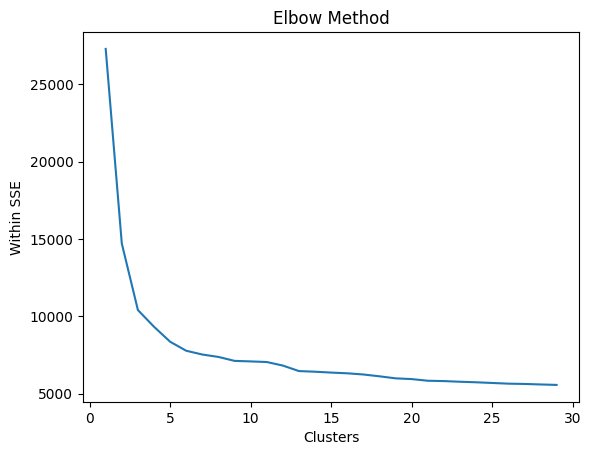

In [21]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

sse = []
cluster_list = range(1, 30)
for i in cluster_list :
    kmeans = KMeans(n_clusters = i, random_state = 2021)
    kmeans.fit(train_data)
    sse.append(kmeans.inertia_)
plt.plot(cluster_list, sse)
plt.title('Elbow Method')
plt.xlabel('Clusters')
plt.ylabel('Within SSE')
plt.show()

## 轮廓法确定聚类中心数量

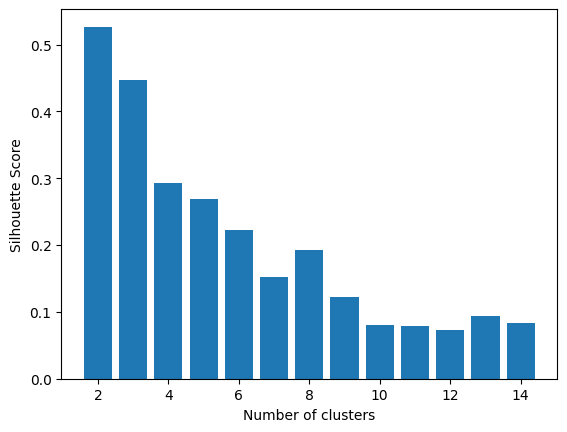

In [22]:
# 轮廓法

from sklearn.metrics import silhouette_score
s = [] 
cluster_list = range(2, 15)
for i in cluster_list:
    kmeans = KMeans(n_clusters = i, random_state = 2021)
    s.append(silhouette_score(train_data, kmeans.fit_predict(train_data))) 
    
# Plotting a bar graph to compare the results 
plt.bar(cluster_list, s) 
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Silhouette Score', fontsize = 10) 
plt.show()

## 中心数量为5进行聚类

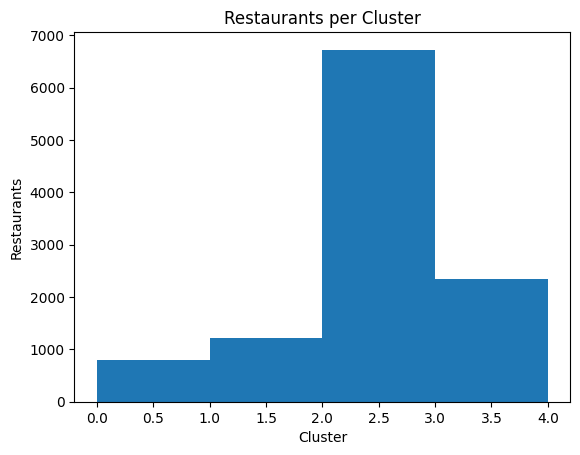

In [23]:
kmeans = KMeans(n_clusters = 5, random_state = 2021) 
labels = kmeans.fit_predict(train_data)
df["cluster"] = labels
# plot cluster sizes
plt.hist(labels, bins = range(5))
plt.title ('Restaurants per Cluster')
plt.xlabel('Cluster')
plt.ylabel('Restaurants')
plt.show()

In [24]:
import folium
import os
from folium import plugins

# 中心点大致在费城
latitude, longitude = 39.95, -75.16

# 创建地图对象
trt_map = folium.Map(location=[latitude, longitude], zoom_start=12)


# 每一行包含 name、latitude、longitude、cluster 等字段
colors = ['red', 'blue', 'green', 'purple', 'orange', 'pink', 'gray', 'black']

# 添加点到地图
for idx, row in df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=4,
        popup=row['name'],
        color=colors[int(row['cluster']) % len(colors)],
        fill=True,
        fill_color=colors[int(row['cluster']) % len(colors)]
    ).add_to(trt_map)

# 显示地图
trt_map

## 查看聚类中心的餐馆类别分布

## *柱状图*

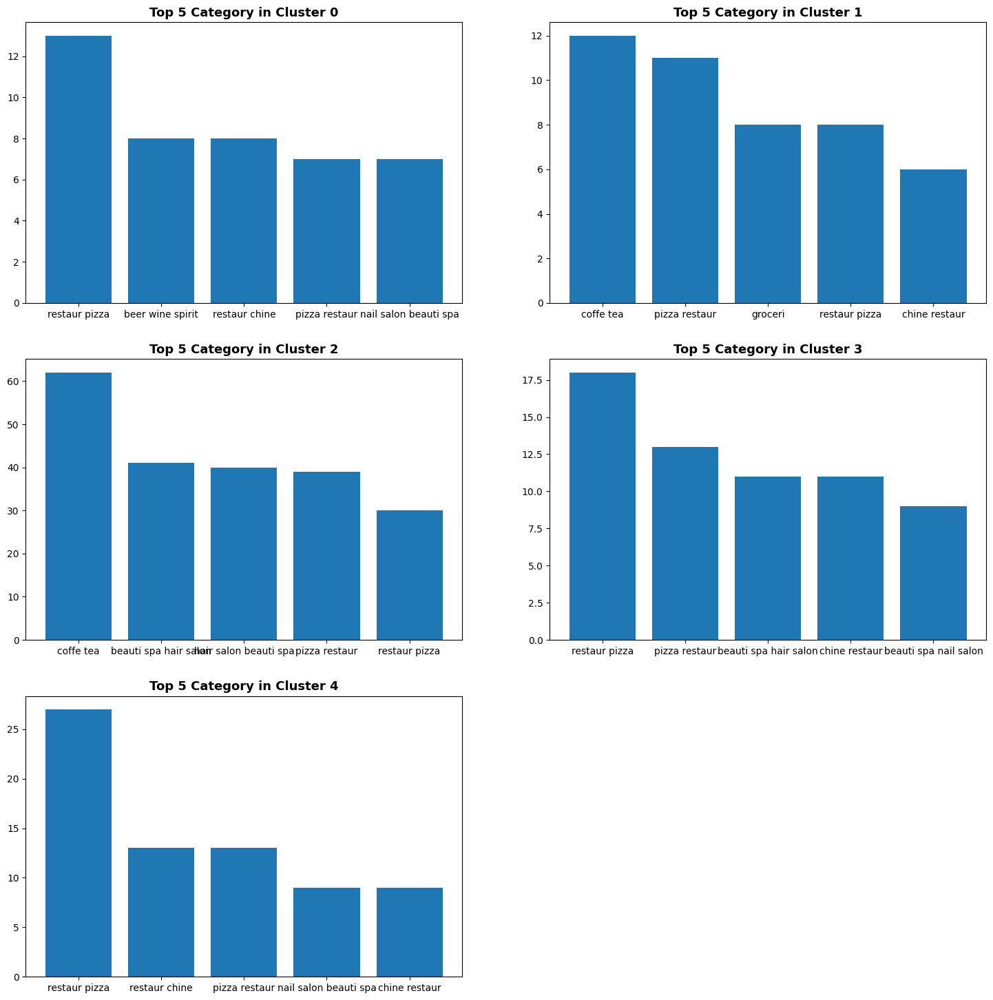

In [25]:
# 聚类结果展示， 查看每个簇中排名前5的categories

plt.figure(figsize = (18,18))
for i in range(0, 5):
    cluster_data = df[df['cluster'] == i]
    category_str = ','.join(cluster_data['category_preprocessed'])
    category_list = category_str.split(',')
    category_df = pd.DataFrame(category_list, columns = ['category'])
    top5_category = category_df['category'].value_counts()[:5]
    plt.subplot(3,2,i+1)
    plt.bar(top5_category.index,top5_category)
    plt.title('Top 5 Category in Cluster ' + str(i), fontsize = 13, fontweight = 'bold')
plt.show()

## *词云图*

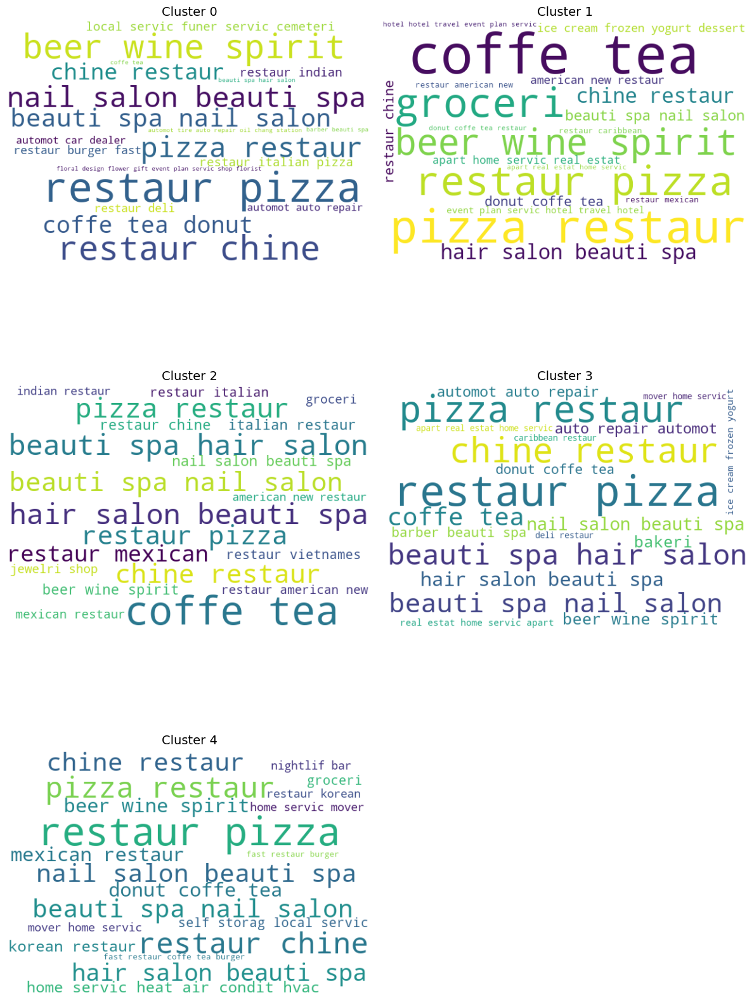

In [26]:
from gensim import corpora, models
from wordcloud import WordCloud
import math

n_clusters = df['cluster'].nunique()

# 文本预处理
def preprocess_categories(cat_str):
    return [x.strip().lower() for x in cat_str.split(',') if x.strip()]

# 画词云
fig_cols = 2
fig_rows = math.ceil(n_clusters / fig_cols)

fig, axes = plt.subplots(fig_rows, fig_cols, figsize=(12, 6 * fig_rows))
axes = axes.flatten() 

for idx, i in enumerate(range(n_clusters)):
    cluster_data = df[df['cluster'] == i]
    processed_docs = cluster_data['category_preprocessed'].dropna().apply(preprocess_categories)
    
    if processed_docs.empty:
        continue

    dictionary = corpora.Dictionary(processed_docs)
    corpus = [dictionary.doc2bow(text) for text in processed_docs]
    lda_model = models.LdaModel(corpus=corpus, id2word=dictionary, num_topics=1, passes=10, random_state=42)
    topic_terms = dict(lda_model.show_topic(0, topn=20))

    wc = WordCloud(width=600, height=400, background_color='white')
    wc.generate_from_frequencies(topic_terms)

    ax = axes[idx]
    ax.imshow(wc, interpolation='bilinear')
    ax.set_title(f'Cluster {i}', fontsize=14)
    ax.axis('off')

# 删除多余的空子图
for j in range(n_clusters, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

## *获取convinence_index*

In [27]:
# 1. 获取聚类中心
centroids = kmeans.cluster_centers_


# 2. 计算每个商户到对应聚类中心（标准化后的经纬度）的距离
distances = []
for i, row in enumerate(data_s):
    cluster_id = df["cluster"].iloc[i] 
    center = centroids[cluster_id][:2]
    distance = np.linalg.norm(row - center)
    distances.append(distance)



# 3. 得到convenience 
distances = np.array(distances)  

d_min = distances.min()
d_max = distances.max()

convenience = 1 - (distances - d_min) / (d_max - d_min)

# 添加回DataFrame
df['convenience_index'] = convenience


df.head()


,business_id,name,city,state,latitude,longitude,stars,attr_GoodForKids,attr_RestaurantsTakeOut,attr_BusinessAcceptsCreditCards,...,attr_RestaurantsAttire_missing,attr_NoiseLevel_average,attr_NoiseLevel_loud,attr_NoiseLevel_missing,attr_NoiseLevel_quiet,attr_NoiseLevel_very_loud,weekly_hours,category_preprocessed,cluster,convenience_index
0,QVu5RffO04nc7JWT8pqlQw,Nan Yang Asian Cuisine,Philadelphia,PA,39.95517,-75.15551,3.5,True,True,True,...,0.0,1.0,0.0,0.0,0.0,0.0,94.0,thai restaur singaporean malaysian asian fusion,2,0.986434
1,m_5jK3w7t4CS2ReIZI_grQ,Fat Tuesday,Philadelphia,PA,39.941876,-75.150251,2.5,False,False,True,...,0.0,0.0,0.0,0.0,0.0,1.0,98.0,ice cream frozen yogurt restaur american tradi...,2,0.973751
2,e3Y3hDpwHc9RmQlJtIgHuw,Lacroix Restaurant at The Rittenhouse,Philadelphia,PA,39.949913,-75.173645,4.5,False,False,True,...,0.0,0.0,0.0,0.0,1.0,0.0,78.5,restaur breakfast brunch brazilian american ne...,2,0.966964
3,r1g9VYLve8rfL3NUqA4uWw,Recess Lounge,Philadelphia,PA,39.947602,-75.144463,2.0,False,False,True,...,1.0,0.0,0.0,0.0,0.0,1.0,15.0,loung nightlif bar,2,0.968900
4,htkrEPPQg6iH2QoBDjrEJw,Fresh Donuts,Philadelphia,PA,39.962212,-75.201024,5.0,False,True,True,...,1.0,0.0,0.0,1.0,0.0,0.0,75.0,donut breakfast brunch restaur coffe tea,1,0.952664


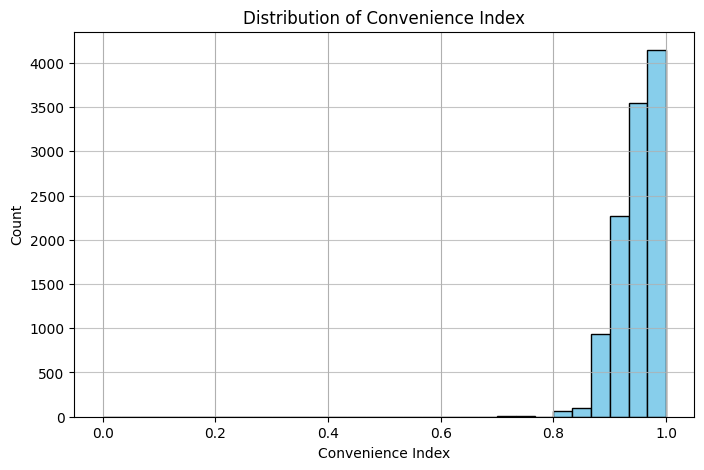

In [52]:
# convenience_index直方图
plt.figure(figsize=(8, 5))
df["convenience_index"].hist(bins=30, color='skyblue', edgecolor='black')

plt.xlabel("Convenience Index")
plt.ylabel("Count")
plt.title("Distribution of Convenience Index")
plt.grid(axis='y', alpha=0.75)
plt.show()

stars
1.0      81
1.5     246
2.0     571
2.5     878
3.0    1286
3.5    1973
4.0    2582
4.5    2295
5.0    1165
Name: count, dtype: Int64


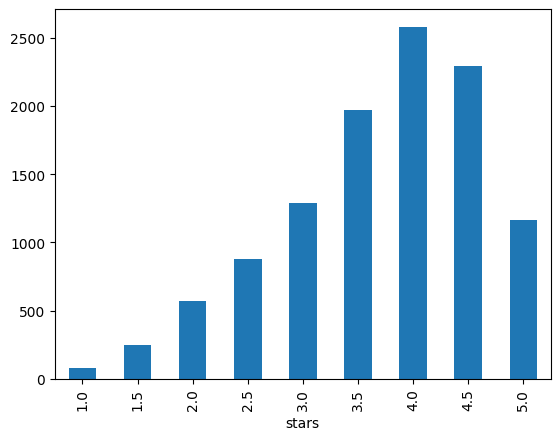

In [49]:
#根据餐馆的stars得分进行分类统计

data_stars_count = df["stars"].value_counts().sort_index()  

print(data_stars_count)

data_stars_count.plot.bar()
plt.show()

In [50]:
# 筛选评分小于等于3.5的餐馆
stars_le_35_data = df[df["stars"] <= 3.5]

# 创建特征组
incidents = folium.map.FeatureGroup()

latitudes = list(stars_le_35_data.latitude)
longitudes = list(stars_le_35_data.longitude)

for lat, lng in zip(latitudes, longitudes):
    incidents.add_child(
        folium.CircleMarker(
            [lat, lng],
            radius=5,
            color='yellow',
            fill=True,
            fill_color='red',
            fill_opacity=0.4
        )
    )

# 添加到地图
trt_map = folium.Map(location=[latitude, longitude], zoom_start=12)
trt_map.add_child(incidents)


In [51]:
import folium

# 筛选 stars > 3.5 的餐馆
df_gt_35 = df[df['stars'] > 3.5]

# 创建特征组
incidents = folium.map.FeatureGroup()

for _, row in df_gt_35.iterrows():
    lat = row['latitude']
    lng = row['longitude']
    star = row['stars']

    # 星级为5的用绿色，其他用蓝色
    if star == 5.0:
        color = 'green'
        fill_color = 'green'
    else:
        color = 'blue'
        fill_color = 'blue'

    incidents.add_child(
        folium.CircleMarker(
            location=[lat, lng],
            radius=5,
            color=color,
            fill=True,
            fill_color=fill_color,
            fill_opacity=0.5
        )
    )

# 假设地图中心为该数据均值位置
center_lat = df_gt_35['latitude'].mean()
center_lng = df_gt_35['longitude'].mean()

# 创建地图
map_gt_35 = folium.Map(location=[center_lat, center_lng], zoom_start=12)
map_gt_35.add_child(incidents)

# 显示地图
map_gt_35


In [28]:
print('business_id' in df.columns)

True


In [29]:
# ───────────────────── 2. name → TF-IDF → TruncatedSVD ───────────────────── #
tfidf_name = TfidfVectorizer(
    min_df=2,              # 过滤只出现 1 次的词，可按需调
    ngram_range=(1, 2),    # 单词 + 二元短语
)
X_name = tfidf_name.fit_transform(df["name"].fillna(""))

# 稀疏 SVD，不需要 .toarray()
svd_dim_name = 50          # 输出维度，可根据数据量/内存调节
svd_name = TruncatedSVD(
    n_components=svd_dim_name,
    random_state=42,
)
X_name_svd = svd_name.fit_transform(X_name)   # 直接稀疏矩阵输入

# 转成 DataFrame 便于拼接
name_svd_cols = [f"name_svd_{i}" for i in range(svd_dim_name)]
df_name_svd   = pd.DataFrame(X_name_svd, columns=name_svd_cols, index=df.index)


In [30]:
# ───────────────────── 3. 合并 & 清理 ───────────────────── #
# 这里用的是刚刚得到的 SVD 与 One-Hot 结果：
#   • df_cat_svd  ——  category_preprocessed 经 TruncatedSVD
#   • df_name_svd ——  name 经 TruncatedSVD
#   • df_loc      ——  city + state 的 One-Hot
# 如变量名与你的实际代码不同，请相应替换

df_final = pd.concat(
    [
        # 去掉原始文本列，保留其它已有数值 / 布尔特征
        df.drop(columns=["category_preprocessed", "name", "city", "state"]),
        df_cat_svd,
        df_name_svd,
    ],
    axis=1
)
print('cluster' in df_final.columns)            
print('convenience_index' in df_final.columns)  

print("最终 df 形状:", df_final.shape)
print(df_final.head())

True
True
最终 df 形状: (11077, 187)
              business_id   latitude  longitude  stars  attr_GoodForKids  \
0  QVu5RffO04nc7JWT8pqlQw   39.95517  -75.15551    3.5              True   
1  m_5jK3w7t4CS2ReIZI_grQ  39.941876 -75.150251    2.5             False   
2  e3Y3hDpwHc9RmQlJtIgHuw  39.949913 -75.173645    4.5             False   
3  r1g9VYLve8rfL3NUqA4uWw  39.947602 -75.144463    2.0             False   
4  htkrEPPQg6iH2QoBDjrEJw  39.962212 -75.201024    5.0             False   

   attr_RestaurantsTakeOut  attr_BusinessAcceptsCreditCards  attr_BikeParking  \
0                     True                             True             False   
1                    False                             True              True   
2                    False                             True              True   
3                    False                             True             False   
4                     True                             True              True   

   attr_HasTV  attr_Res

# 2.预测模型的构建

In [31]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, r2_score
from xgboost import XGBRegressor
from sklearn.model_selection import GridSearchCV, KFold

In [32]:
# ────────────────── 1. 准备特征 / 标签 ────────────────── #
target = "stars"

X = df_final.drop(columns=[target,'business_id']).values.astype(np.float32)
y = df_final[target].values.astype(np.float32)

business_ids = df_final["business_id"]

# 拆分验证集 8:2
from sklearn.model_selection import train_test_split
X_train, X_valid, y_train, y_valid, id_train, id_valid = train_test_split(
    X, y, business_ids, test_size=0.2, random_state=42
)

# 现在你有验证集的 business_id 可以用：
print(id_valid.head())

5880    zLRRim8tu00cvU7QjAJAmQ
9581    UsS0kw-8FV4iBbohrP4v7g
7936    rjObkBLqlve8SAN9hUYygQ
6913    96752mk7VlAUtWg8o02Tvw
2485    0ll5CZSx6qVVV2TJPcW6mA
Name: business_id, dtype: string


In [33]:
# ────────────────── 2. 配置 XGBoost ────────────────── #
params = dict(
    n_estimators      = 800,        # 树的数量
    max_depth         = 8,
    learning_rate     = 0.05,
    subsample         = 0.8,
    colsample_bytree  = 0.8,
    reg_lambda        = 1.0,
    objective         = "reg:squarederror",
    predictor         = "gpu_predictor",   # 同上
    random_state      = 42,
    eval_metric      = "mae",
    n_jobs            = -1,                # CPU 线程数（GPU 也用得到）
)

model = XGBRegressor(**params)

In [34]:
# ────────────────── 3. 训练 ────────────────── #
model.fit(
    X_train, y_train,
    eval_set=[(X_valid, y_valid)],
    verbose=50        # 每 50 轮打印一次验证误差
)

[0]	validation_0-mae:0.73309


E:\Python311\Lib\site-packages\xgboost\training.py:183: UserWarning: [13:32:17] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "predictor" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


[50]	validation_0-mae:0.59110
[100]	validation_0-mae:0.57500
[150]	validation_0-mae:0.57122
[200]	validation_0-mae:0.57193
[250]	validation_0-mae:0.57162
[300]	validation_0-mae:0.57211
[350]	validation_0-mae:0.57251
[400]	validation_0-mae:0.57291
[450]	validation_0-mae:0.57330
[500]	validation_0-mae:0.57357
[550]	validation_0-mae:0.57375
[600]	validation_0-mae:0.57403
[650]	validation_0-mae:0.57397
[700]	validation_0-mae:0.57408
[750]	validation_0-mae:0.57433
[799]	validation_0-mae:0.57444


XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.8, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric='mae', feature_types=None,
             feature_weights=None, gamma=None, grow_policy=None,
             importance_type=None, interaction_constraints=None,
             learning_rate=0.05, max_bin=None, max_cat_threshold=None,
             max_cat_to_onehot=None, max_delta_step=None, max_depth=8,
             max_leaves=None, min_child_weight=None, missing=nan,
             monotone_constraints=None, multi_strategy=None, n_estimators=800,
             n_jobs=-1, num_parallel_tree=None, ...)

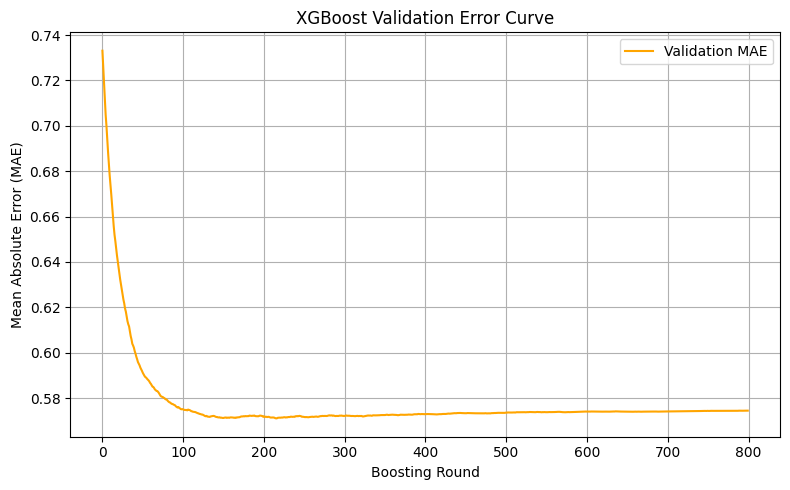

In [35]:
# ────────────────── 4. MSE损失函数曲线 ────────────────── #

results = model.evals_result()
plt.figure(figsize=(8,5))
plt.plot(results['validation_0']['mae'], label='Validation MAE', color='orange')
plt.xlabel('Boosting Round')
plt.ylabel('Mean Absolute Error (MAE)')
plt.title('XGBoost Validation Error Curve')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
'''
# ────────────────── 1. 准备特征 / 标签 ────────────────── #
target = "stars"

X = df_final.drop(columns=[target, 'business_id']).values.astype('float32')
y = df_final[target].values.astype('float32')
business_ids = df_final["business_id"]



# ────────────────── 2. 模型配置 ────────────────── #
xgb_model = XGBRegressor(
    objective="reg:squarederror",
    predictor="gpu_predictor",
    eval_metric="mae",
    random_state=42,
    n_jobs=-1
)

# ────────────────── 3. 搜索空间（范围小，速度快） ────────────────── #
param_dist = {
    "n_estimators": randint(300, 800),
    "max_depth": randint(4, 8),
    "learning_rate": uniform(0.02, 0.05),  # 范围：0.02 ~ 0.07
    "subsample": uniform(0.7, 0.2),        # 范围：0.7 ~ 0.9
    "colsample_bytree": uniform(0.6, 0.3), # 范围：0.6 ~ 0.9
    "reg_lambda": uniform(0.5, 1.5),       # 范围：0.5 ~ 2.0
    "reg_alpha": uniform(0, 1.0),          # 范围：0 ~ 1.0
    "min_child_weight": randint(1, 6)
}

# ────────────────── 4. 交叉验证配置（5折） ────────────────── #
cv = KFold(n_splits=5, shuffle=True, random_state=42)

# ────────────────── 5. 启动随机搜索（只尝试30组） ────────────────── #
random_search = RandomizedSearchCV(
    estimator=xgb_model,
    param_distributions=param_dist,
    n_iter=30,                 # 搜索轮数，越少越快
    scoring='neg_mean_absolute_error',
    cv=cv,
    verbose=1,
    n_jobs=-1,
    random_state=42
)

# ────────────────── 6. 执行搜索 ────────────────── #
random_search.fit(X, y)

print("Best parameters:", random_search.best_params_)
print("Best CV MAE:", -random_search.best_score_)
'''

In [39]:
importances = model.feature_importances_

# 提取特征名
feat_names = df_final.drop(columns=[target,'business_id']).columns

# 构建重要性表格
feat_imp_df = pd.DataFrame({
    "feature": feat_names,
    "importance": importances
})

# 按重要性排序并展示前20个
feat_imp_df.sort_values(by="importance", ascending=False).head(20)


,feature,importance
26,attr_RestaurantsAttire_missing,0.024234
31,attr_NoiseLevel_very_loud,0.018304
13,attr_ByAppointmentOnly,0.017475
67,cat_svd_32,0.014663
58,cat_svd_23,0.012968
53,cat_svd_18,0.012895
139,name_svd_4,0.012423
40,cat_svd_5,0.011839
160,name_svd_25,0.011745
32,weekly_hours,0.011448




Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



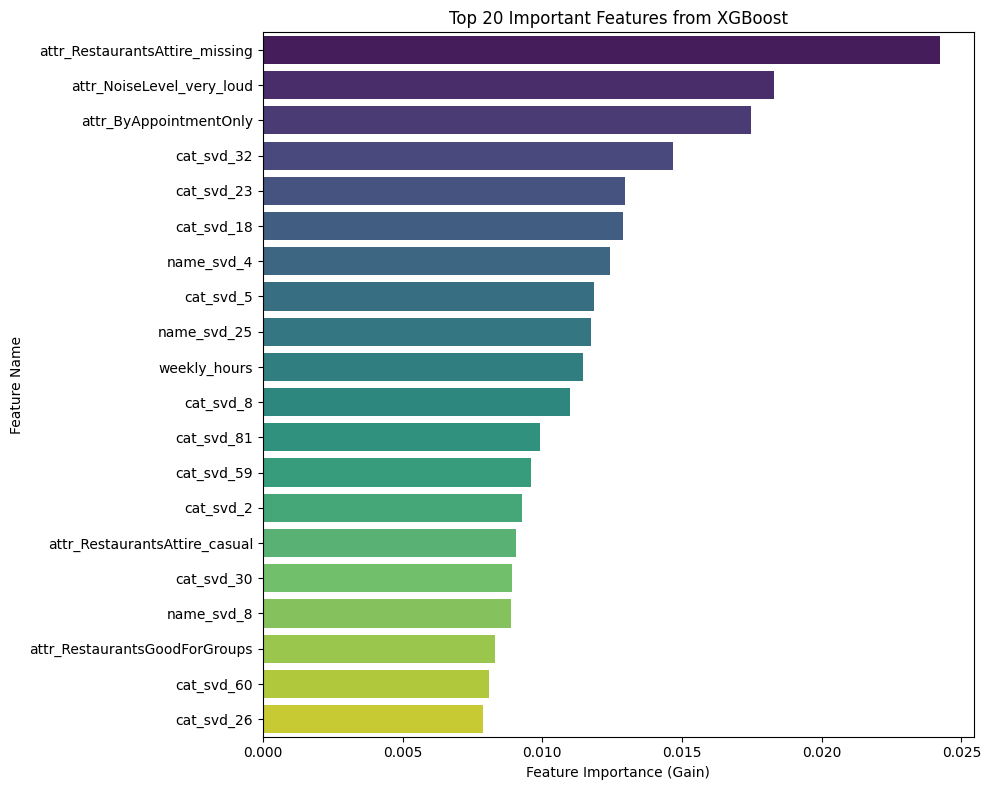

In [47]:
import seaborn as sns

# 取前 20 个重要特征
top_n = 20
feat_top = feat_imp_df.sort_values(by="importance", ascending=False).head(top_n)

plt.figure(figsize=(10, 8))
sns.barplot(data=feat_top, x="importance", y="feature", palette="viridis")

plt.title(f"Top {top_n} Important Features from XGBoost")
plt.xlabel("Feature Importance (Gain)")
plt.ylabel("Feature Name")
plt.tight_layout()
plt.show()

In [40]:
feat_imp_df[feat_imp_df["feature"] == "convenience_index"]

,feature,importance
34,convenience_index,0.003025


# 3.好评率的构建和优质商户的筛选

In [41]:
df_reviews = pd.read_csv("./reviews_of_restaurants.txt", sep="\t")
df_reviews

,review_id,user_id,business_id,stars,date,useful,text
0,JBWZmBy69VMggxj3eYn17Q,aFa96pz67TwOFu4Weq5Agg,kq5Ghhh14r-eCxlVmlyd8w,5.0,2018-08-23 21:39:38,0,My boyfriend and I tried this deli for the fir...
1,4KpIldEM-tdnrJLqYzRfZQ,Z5j9Xw_G0c7M2b1-iS67wg,HTqXI5S2XcSlh_ylx9sE6g,5.0,2018-03-23 14:35:33,1,I've only had the cannolis here but they are a...
2,gImS1dtA_TixEouDfp2o4g,xE7AXFF9wVaN6id6OCtH3Q,D5V0Fawd6ODVgqCY8xngsw,4.0,2017-01-14 21:05:04,1,I have been to a number of dog friendly hotels...
3,dUkUiVjwb9xCF1kMqjT6nA,EDPlya2Sfu0teqreA3rlZw,FnEkr6LzjuGsg93Z7fkl7Q,2.0,2017-12-29 20:44:06,0,"Before I share the main issue, I want to share..."
4,g7MfpJGKQUGowCvIcrB91A,ci7Q6NvXQ8UZrBHusVX18g,V6Om7YZhlRQRU7WfuxHq8Q,4.0,2017-07-08 21:23:54,1,A wee bit pricey for the portions they serve. ...
...,...,...,...,...,...,...,...
217296,L_KJJb7J9AQzQtD519xRFQ,uLKdql1tyU4rj6dEDkz3nQ,vhDWGF-8BfsxvS7Zo5Wv2w,5.0,2019-01-26 22:30:24,3,"After much deliberation, we decided to try Abe..."
217297,YAAmRuqBqaFV6kW6ozjBpQ,aFLEltFU8TVgYS1C6tzuUA,8XjxHeV66F4eoIy06rW0pA,5.0,2018-08-04 17:47:21,4,"Porta, Porta, Porta, one of my new FAVORITE sp..."
217298,UKSW7aMzc32KQC_eNwRazg,iTA7VqmHkEX3sUtJLpxHdw,qDEcJ48kXdWxQGZefgG94w,5.0,2019-07-01 06:38:29,2,Incredible and amazing. We always come here wh...
217299,5n_oSwXspiiSsZgNwjp48g,bJ5FtCtZX3ZZacz2_2PJjA,SOsjW1JARmtHUFtpFlp8rw,4.0,2017-02-23 19:11:04,5,When I first heard that the Peace A Pizza (htt...


In [42]:
# 筛选验证集商家的评论，做显式拷贝避免警告
df_reviews_filtered = df_reviews[df_reviews["business_id"].isin(id_valid)].copy()

# 统计每个商家的评论数
comment_counts = df_reviews_filtered.groupby("business_id")["review_id"].count()
print(comment_counts)

# 平均评论数
average_reviews = comment_counts.mean()
print(f"每个商户的平均评论数为：{average_reviews:.2f}")


# 转换日期格式
df_reviews_filtered["date"] = pd.to_datetime(df_reviews_filtered["date"])

# 按商家和日期排序，取每个商家的前50条评论
df_reviews_filtered = df_reviews_filtered.sort_values(["business_id", "date"])
df_top50 = df_reviews_filtered.groupby("business_id").head(50).copy()

df_top50

business_id
-3m_nXlyvdKAVNNmVirpGQ     6
-Ah-gbZpa-IiQVIrhKRhhA     1
-NG3pA9LEXCxt0Fjd_aYYA    29
-hCwC548xGJObF9NLeN5JA     7
-k1iNvlyQZkZ14Hcqzlk4Q     6
                          ..
zjTBfbvbN2Ps6_Ar0w-fuQ    83
zmyfGGhj4SiHept2dDAsSg     8
zpKTPWoW56wF6d9qNnxM3Q    87
zropQGh2fc7PMpzd32vneQ    70
zssISv4ZdplRT_Zcw8drPQ    91
Name: review_id, Length: 725, dtype: int64
每个商户的平均评论数为：58.65


,review_id,user_id,business_id,stars,date,useful,text
157139,RYWnSir__4qsqXy1rszskw,k6AwCajLT06J6cwC3SqFcg,-3m_nXlyvdKAVNNmVirpGQ,5.0,2017-09-26 15:57:11,0,It's weird that they don't deliver to my locat...
167553,eSoCNeeWKYKlDKGPRcxYsA,GhuMzO3JVds90tweXV5t7A,-3m_nXlyvdKAVNNmVirpGQ,3.0,2018-03-31 18:04:15,0,Attention! This restaurant is actually located...
165187,f2mHfvfY3L995OSMyrQuRA,NUldEL7P9Q6Ejn6OgUrCnw,-3m_nXlyvdKAVNNmVirpGQ,5.0,2018-05-17 18:30:57,0,This place had delicious food! And delivery wa...
165292,nqu6OzQ5Rs0z0NRHp8pQIA,Dc1SYOXgKFGMXnPLEgtooQ,-3m_nXlyvdKAVNNmVirpGQ,5.0,2019-08-11 22:19:00,0,What's not to like about a classic Philly Chee...
167038,zkpVgyoIADji1q6Q_xKzyw,qi3RDd1TfZQwVza43RSC_Q,-3m_nXlyvdKAVNNmVirpGQ,1.0,2019-10-19 04:34:43,0,"Place is called Ed's, not Ranas Maybe the piz..."
...,...,...,...,...,...,...,...
109117,6E28hk0Delm2Gn4pTS6vQA,MuuzyAfROfPbnkQCdcYTQw,zssISv4ZdplRT_Zcw8drPQ,1.0,2019-03-17 22:54:16,2,The waitress that told me the cheesy crab frie...
106472,uG0-mRzFdxpgGUZP1Nkatg,QJWeOzDL5tIAp0l6kors4g,zssISv4ZdplRT_Zcw8drPQ,2.0,2019-03-23 21:46:05,1,I ordered the chicken sandwich. It was good ex...
105362,41C9_JZU1XotxJ6P_0TmdQ,RZO4mXMQ3ETRSilbtXoL_w,zssISv4ZdplRT_Zcw8drPQ,2.0,2019-03-31 17:18:30,1,Disgusting restrooms! And they had the nerve t...
103785,vV5gOQT_YBVnkmaDuIw-8g,_4U1WoHwmzzHYiNexzmrNw,zssISv4ZdplRT_Zcw8drPQ,1.0,2019-03-31 18:01:30,1,Horrible. I have been here twice and each time...


In [43]:
comment_counts = df_top50.groupby("business_id").size()

# 先在筛选后的 df_reviews_filtered 中统计每个商户总评论数
full_comment_counts = df_reviews_filtered.groupby("business_id").size()

# 计算总商户数量
total_business = full_comment_counts.shape[0]

# 计算评论数大于50的商户数量
over_50_business = (full_comment_counts > 50).sum()

# 计算比例
ratio_over_50 = over_50_business / total_business

print(f"评论数超过50条的商户数量: {over_50_business}")
print(f"总商户数量: {total_business}")
print(f"评论数超过50条的商户比例: {ratio_over_50:.2%}")


评论数超过50条的商户数量: 245
总商户数量: 725
评论数超过50条的商户比例: 33.79%


In [44]:
from text_preprocessing import preprocess
from textblob import TextBlob

# 用你写的预处理函数对文本预处理
df_top50["text_preprocessed"] = df_top50["text"].apply(preprocess)

# 再把预处理后的词列表合成句子，方便情感分析
df_top50["text_for_sentiment"] = df_top50["text_preprocessed"].apply(lambda x: " ".join(x))

# 计算情感极性
df_top50["polarity"] = df_top50["text_for_sentiment"].apply(lambda x: TextBlob(x).sentiment.polarity)

# 设阈值判断好评
df_top50["is_positive"] = df_top50["polarity"] > 0.2

# 计算每家商户好评率
positive_rate_df = (
    df_top50.groupby("business_id")["is_positive"]
    .mean()
    .reset_index()
    .rename(columns={"is_positive": "positive_rate"})
)

print(positive_rate_df.head())

              business_id  positive_rate
0  -3m_nXlyvdKAVNNmVirpGQ       0.333333
1  -Ah-gbZpa-IiQVIrhKRhhA       1.000000
2  -NG3pA9LEXCxt0Fjd_aYYA       0.827586
3  -hCwC548xGJObF9NLeN5JA       0.428571
4  -k1iNvlyQZkZ14Hcqzlk4Q       0.500000


In [45]:
# 构建验证集 DataFrame
df_valid = pd.DataFrame({
    "business_id": id_valid,
    "stars": y_valid
})


# 1. 从验证集中提取每个商户 stars（目标变量）
stars_df = df_valid.groupby("business_id")["stars"].mean().reset_index()

# 2. 合并好评率（positive_rate_df 是上一步计算的）
merged_df = stars_df.merge(positive_rate_df, on="business_id")

# 3. 排序：先按 stars 降序，再按 positive_rate 降序
merged_df_sorted = merged_df.sort_values(by=["stars", "positive_rate"], ascending=[False, False])

# 4. 取前 10 个商户
top10_businesses = merged_df_sorted.head(10)

# 5. 查看结果
top10_businesses


,business_id,stars,positive_rate
78,6085NRg7QH3vXpc50F4UHQ,5.0,1.000000
312,QJZdu9kFpKh4Fy8_YuvvXQ,5.0,1.000000
423,YbpNzwI5iBvsBDwdwc9Mmg,5.0,1.000000
652,tyFuhfn1BDGHWpmwpkwBAQ,5.0,1.000000
284,NDHgJsy-4Lb6WhERPXPs0A,5.0,0.928571
258,Ktg3ahIxk0JIkJwXAqu2ew,5.0,0.920000
472,cVV8GWVIe9BwyCOKwrFgPA,5.0,0.860000
510,fq1yCVBgBB7s6V-D68NO1g,5.0,0.837209
79,609Lr-Hvo3sr9amdiimOJA,5.0,0.818182
263,LHzg5i6hX1Qb3OxtWJ4QDQ,5.0,0.800000
